# **Fold Geometry Image Classification Tool**

***By Ramy Abdallah***

# **Introduction**

The application of machine learning is being presented as a new solution to a wide range of geoscience problems over the last decade. This study aims to use machine learning techniques to classify geological subsurface structural images of folds and fold-thrust structures besides building a standard public dataset for similar investigations. Primarily machine learning has been used for 3D seismic data processing, seismic facies analysis and well log data correlation. The rapid development in technology with open-source artificial intelligence libraries and the accessibility of affordable computer graphics processing units (GPU) makes the application of machine learning in geosciences more convenient. Moreover, deep neural networks techniques such as convolutional neural networks (CNNs) algorithms have the capability to help accelerate geological interpretation, with applications ranging from supervised horizons and faults interpretation to the application of validation techniques. However, the application of artificial intelligent in structural interpretation workflows of subsurface datasets is still ambiguous. Here we show that convolutional neural networks (CNNs) provide excellent algorithms to discriminate between geological images datasets. Four different datasets of images have been used to train and test the machine learning models separately. These four datasets are seismic character dataset with five classes (faults, folds, salt, flat layers and basement), folds types with three classes (buckle, chevron and conjugate), fault types with three classes (normal, reverse and thrust) and fold-thrust geometries with three classes (fault bend fold, fault propagation fold and detachment fold). These images datasets investigate three machine learning models (Feedforward linear neural network, Convolution 2d layer transforms (Cifar10CnnModel) and Residual block (ResNet9)) where the ResNet9 model records the highest performance accuracy score. Together these datasets form a critical part of testing the models’ accuracy. Convolutional neural networks (CNN) classification models are applicable to other sub-surface datasets and can be a starting point to apply machine learning methods to sub-surface structural interpretations workflows. We claim that our CNN image classification model’s analysis provides a framework for applying machine learning to increase structural interpretation efficiency by revealing the performance score of interpretations to the image datasets.

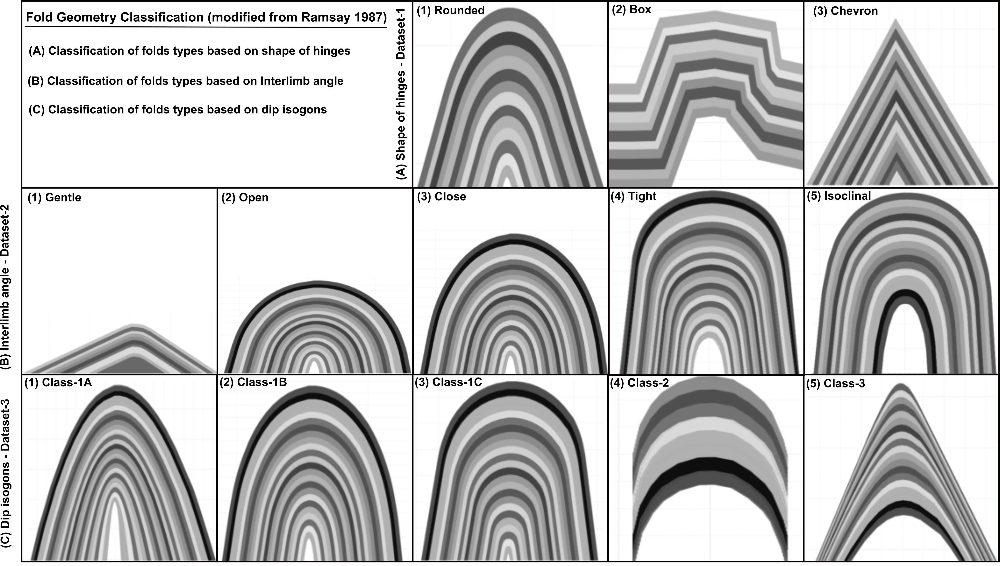

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In this Deep Neural Network project, I trained a `ResNet-n (n=9,32, 152)` neural networks architecture with a different layers to classify three datasets of fold types created specificaly for this study based on Ramsay fold classification (Ramsay 1987).The model reach over all accuracy of `over 75% accuracy`. For this project, I used the **Shape of the hinges dataset**, which consists of three fold types (3 classes). 3243 training images (1081 per class), 68 test images and 300 validation images(100 per class). All images are set to a target size of 224 X 224 X 3. The images were tested as color images and grey scale  images.

# **1. Let's begin by installing and importing the required libraries.**

In [ ]:
# Uncomment and run the appropriate command for your operating system, if required
# No installation is reqiured on Google Colab / Kaggle notebooks

# Linux / Binder / Windows (No GPU)
# !pip install numpy matplotlib torch==1.7.0+cpu torchvision==0.8.1+cpu torchaudio==0.7.0 -f https://download.pytorch.org/whl/torch_stable.html

# Linux / Windows (GPU)
# pip install torch==1.7.1+cu110 torchvision==0.8.2+cu110 torchaudio==0.7.2 -f https://download.pytorch.org/whl/torch_stable.html
 
# MacOS (NO GPU)
# !pip install numpy matplotlib torch torchvision torchaudio

In [ ]:
import os
import torch
import torchvision
import tarfile
import torch.nn as nn
import numpy as np
import torch.nn.functional as F
from torchvision.datasets.utils import download_url
from torchvision.datasets import ImageFolder
from torch.utils.data import DataLoader
import torchvision.transforms as tt
from torch.utils.data import random_split
from torchvision.utils import make_grid
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline

matplotlib.rcParams['figure.facecolor'] = '#ffffff'

In [ ]:
from PIL import Image
from pathlib import Path
import pandas as pd
import math
import cv2
from scipy import signal

In [ ]:
import keras
from keras.models import Sequential
from keras.layers import Dense,Conv2D,MaxPool2D,Dropout,BatchNormalization,Flatten,Activation
from keras.preprocessing import image 
from keras.preprocessing.image import ImageDataGenerator
import matplotlib.pyplot as plt
from keras.utils import plot_model
import seaborn as sns

In [ ]:
# !pip install jovian --upgrade -q
# import jovian
# jovian.set_project('fold-deep-learning-resnet152-projec-all')
# jovian.set_colab_id('13ioHD681lSaJm8KvyoRVMsHVjhoJtsRt')
# jovian.commit(project=project_name, environment=None)

# **2. Preparing the Folds Geometry Dataset**


## **2.1 Shape of the hinges dataset**

The **Shape of the hinges dataset**, which consists of three fold types (3 classes). 3243 training images (1081 per class), 68 test images and 300 validation images(100 per class). All images are set to a target size of 224 X 224 X 3. The images were tested as color images and grey scale  images.

In [ ]:
print(os.listdir('.'))

['.config', 'drive', 'sample_data']


In [ ]:
# Look into the folds data directory
data_dir = '/content/drive/MyDrive/fold'
print(os.listdir(data_dir))

['TEST', 'VAL', 'TRAIN_OLD_7iana', 'TRAIN_old2_no_augment', 'TRAIN_old3_with hard_augmentation', 'TRAIN']


In [ ]:
classes = os.listdir(data_dir + "/TRAIN")
print(len(classes))
print(classes)

3
['chevron', 'box', 'rounded']


In [ ]:
classes = os.listdir(data_dir + "/VAL")
print(len(classes))
print(classes)

3
['chevron', 'box', 'rounded']


In [ ]:
classes = os.listdir(data_dir + "/TEST")
print(len(classes))
print(classes)

3
['box', 'rounded', 'chevron']


## **2.2 Inspect the Training, Validation and Testing data**

Let's look inside a couple of folders, one from the training set and another from the test set. As an analytic exploration, I can also verify the number of images for each class in the training set as well as in the test set.

In [ ]:
rounded_files = os.listdir(data_dir + "/TRAIN/rounded")
print('No. of training examples for rounded:', len(rounded_files))
print(rounded_files[:10])

No. of training examples for rounded: 1342
['224.PNG', '225.PNG', '226.PNG', '227.PNG', '228.PNG', '229.PNG', '230.PNG', '231.PNG', '232.PNG', '233.PNG']


In [ ]:
chevron_test_files = os.listdir(data_dir + "/TEST/chevron")
print("No. of test examples for chevron:", len(chevron_test_files))
print(chevron_test_files[:5])

No. of test examples for chevron: 22
['download (9).jpg', 'images - 2021-01-01T185130.915.jpg', 'download (16).jpg', 'download (5).jpg', '01604043.jpg']


In [ ]:
chevron_test_files = os.listdir(data_dir + "/VAL/box")
print("No. of test examples for chevron:", len(chevron_test_files))
print(chevron_test_files[:5])

No. of test examples for chevron: 100
['images (945747).jpg', 'images (885855).jpg', '4254578.png', '42545524148.png', '85214752148.png']


In [15]:
for dirname, _, filenames in os.walk('/content/drive/MyDrive/fold'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

Streaming output truncated to the last 5000 lines.
/content/drive/MyDrive/fold/TRAIN_old3_with hard_augmentation/chevron/_43_1091766.jpg
/content/drive/MyDrive/fold/TRAIN_old3_with hard_augmentation/chevron/_49_6145609.jpg
/content/drive/MyDrive/fold/TRAIN_old3_with hard_augmentation/chevron/_46_322566.jpg
/content/drive/MyDrive/fold/TRAIN_old3_with hard_augmentation/chevron/_60_4312422.jpg
/content/drive/MyDrive/fold/TRAIN_old3_with hard_augmentation/chevron/_45_7460997.jpg
/content/drive/MyDrive/fold/TRAIN_old3_with hard_augmentation/chevron/_52_2822376.jpg
/content/drive/MyDrive/fold/TRAIN_old3_with hard_augmentation/chevron/_48_7466307.jpg
/content/drive/MyDrive/fold/TRAIN_old3_with hard_augmentation/chevron/_61_5819911.jpg
/content/drive/MyDrive/fold/TRAIN_old3_with hard_augmentation/chevron/_58_9311719.jpg
/content/drive/MyDrive/fold/TRAIN_old3_with hard_augmentation/chevron/_56_6014335.jpg
/content/drive/MyDrive/fold/TRAIN_old3_with hard_augmentation/chevron/_69_9605392.jpg
/con

## **2.3 Exploring the numbers of fold images Dataset**

I also loop through the folds types Dataset to determine the number of images belonging to each class as follows:

In [16]:
for cls in classes:
  train_images = os.listdir(data_dir + '/TRAIN/' + cls)
  img_count = len(train_images)
  print("Number of images belonging to {} is {}".format(cls, img_count))

Number of images belonging to box is 1222
Number of images belonging to rounded is 1342
Number of images belonging to chevron is 1309


In [17]:
for cls in classes:
  train_images = os.listdir(data_dir + '/VAL/' + cls)
  img_count = len(train_images)
  print("Number of images belonging to {} is {}".format(cls, img_count))

Number of images belonging to box is 100
Number of images belonging to rounded is 100
Number of images belonging to chevron is 100


In [18]:
for cls in classes:
  train_images = os.listdir(data_dir + '/TEST/' + cls)
  img_count = len(train_images)
  print("Number of images belonging to {} is {}".format(cls, img_count))

Number of images belonging to box is 22
Number of images belonging to rounded is 24
Number of images belonging to chevron is 22


## **2.4 Dataset Directory Assignment**

In [19]:
data_dir = '/content/drive/MyDrive/fold'
train_directory= data_dir + '/TRAIN'
test_directory= data_dir + '/TEST'
val_directory= data_dir + '/VAL'

# **3. Images Pre-processing**

## **3.1 Image Rescaling**

In [20]:
train_datagen=ImageDataGenerator(rescale=1/255)
val_datagen=ImageDataGenerator(rescale=1/255)
test_datagen=ImageDataGenerator(rescale=1/255)

## **3.2 Image Reading Using the flow from directory function**

In [21]:
train_generator=train_datagen.flow_from_directory(train_directory,
                                                 target_size=(224,224),
                                                 color_mode='rgb',
                                                  batch_size=256,
                                                 class_mode='sparse')
val_generator=val_datagen.flow_from_directory(val_directory,
                                                 target_size=(224,224),
                                                 batch_size=256,
                                                 color_mode='rgb',
                                                 class_mode='sparse')
test_generator=test_datagen.flow_from_directory(test_directory,
                                                batch_size=256,
                                                 target_size=(224,224),
                                                 color_mode='rgb',
                                                 class_mode='sparse')

Found 3873 images belonging to 3 classes.
Found 300 images belonging to 3 classes.
Found 68 images belonging to 3 classes.


## **3.3 Building Dictionary of folds types Classes**

In [22]:
num_classes=(len(train_generator.class_indices))
print(num_classes)

3


In [23]:
train_generator.class_indices

{'box': 0, 'chevron': 1, 'rounded': 2}

In [24]:
num_classes=(len(val_generator.class_indices))
print(num_classes)

3


In [25]:
val_generator.class_indices

{'box': 0, 'chevron': 1, 'rounded': 2}

In [26]:
num_classes=(len(test_generator.class_indices))
print(num_classes)

3


In [27]:
test_generator.class_indices

{'box': 0, 'chevron': 1, 'rounded': 2}

## **3.4 Data Insight Through Plotting Distribution Graphs**

### **3.4.1 Training dataset**

In [28]:
folds=list(train_generator.class_indices.keys())

In [29]:
x=list(train_generator.classes)

In [30]:
label=[]
for i in range (0, num_classes):
    label.append(x.count(i))

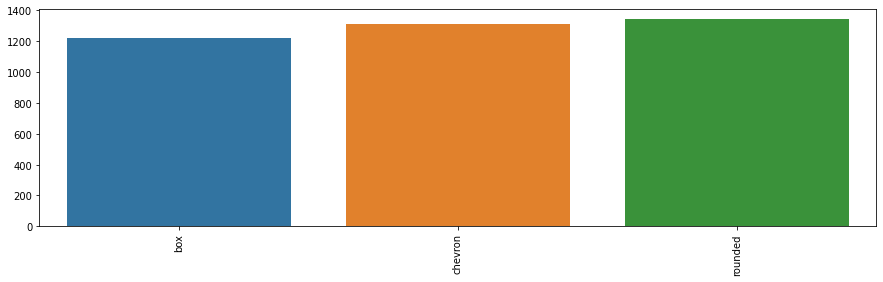

In [31]:
fig_dims = (15, 4)
fig, ax = plt.subplots(figsize=fig_dims)
sns.barplot(x=folds[:60],y=label[:60])
plt.xticks(rotation=90)
plt.show()

### **3.4.2 Validation dataset**

In [32]:
folds=list(val_generator.class_indices.keys())

In [33]:
x=list(val_generator.classes)

In [34]:
label=[]
for i in range (0, num_classes):
    label.append(x.count(i))

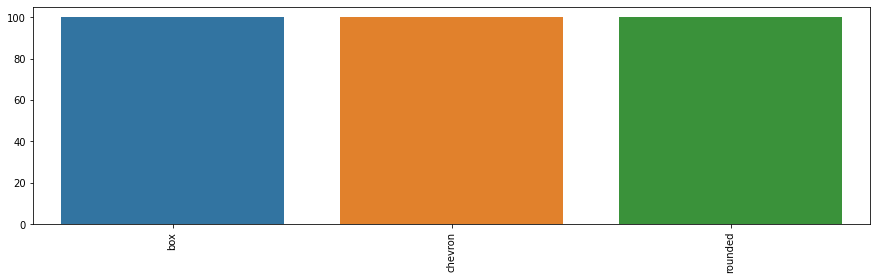

In [35]:
fig_dims = (15, 4)
fig, ax = plt.subplots(figsize=fig_dims)
sns.barplot(x=folds[:60],y=label[:60])
plt.xticks(rotation=90)
plt.show()

### **3.4.3 Testing dataset**

In [36]:
folds=list(test_generator.class_indices.keys())

In [37]:
x=list(test_generator.classes)

In [38]:
label=[]
for i in range (0, num_classes):
    label.append(x.count(i))

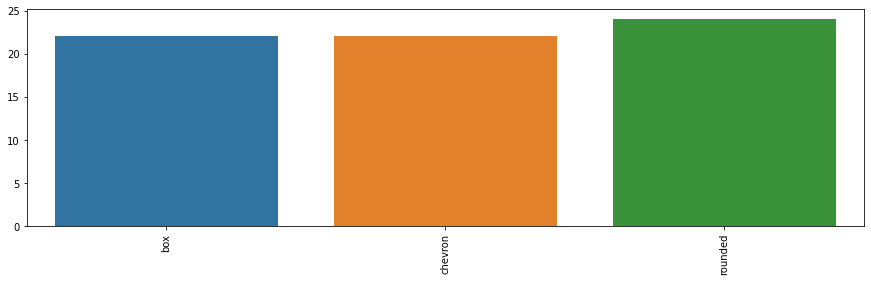

In [39]:
fig_dims = (15, 4)
fig, ax = plt.subplots(figsize=fig_dims)
sns.barplot(x=folds[0:10],y=label[0:10])
plt.xticks(rotation=90)
plt.show()

## **3.5 Examples of folding dataset**

### **3.5.1 Training dataset**

**Class 1 -Chevron fold**

In [40]:
# image1 = np.array(Image.open('/content/drive/MyDrive/fold/TRAIN/chevron/26 (2).PNG'))
# plt.imshow(image1, cmap='gray')

In [41]:
# image1 = np.array(Image.open('/content/drive/MyDrive/fold/TRAIN/chevron/41 (2).PNG'))
# plt.imshow(image1, cmap='gray')

In [42]:
# image1 = np.array(Image.open('/content/drive/MyDrive/fold/TRAIN/chevron/29 (3).PNG'))
# plt.imshow(image1, cmap='gray')

**Class 2 - Box fold**

In [43]:
# image1 = np.array(Image.open('/content/drive/MyDrive/fold/TRAIN/box/g1299.png'))
# plt.imshow(image1, cmap='gray')

In [44]:
# image2 = np.array(Image.open('/content/drive/MyDrive/fold/TRAIN/box/3652.PNG'))
# plt.imshow(image2, cmap='gray')

In [45]:
# image3 = np.array(Image.open('/content/drive/MyDrive/fold/TRAIN/box/32323.PNG'))
# plt.imshow(image3, cmap='gray')

**Class 3 - Rounded fold**

In [46]:
# image3 = np.array(Image.open('/content/drive/MyDrive/fold/TRAIN/rounded/2 (6).png'))
# plt.imshow(image3, cmap='gray')

In [47]:
# image3 = np.array(Image.open('/content/drive/MyDrive/fold/TRAIN/rounded/3.png'))
# plt.imshow(image3, cmap='gray')

In [48]:
# image3 = np.array(Image.open('/content/drive/MyDrive/fold/TRAIN/rounded/43.PNG'))
# plt.imshow(image3, cmap='gray')

### **3.5.2 Validation dataset**

**Class 1 - Chevron fold**

In [49]:
# image2 = np.array(Image.open('/content/drive/MyDrive/fold/VAL/chevron/images123.jpg'))
# plt.imshow(image2, cmap='gray')

In [50]:
# image2 = np.array(Image.open('/content/drive/MyDrive/fold/VAL/chevron/images (333398).jpg'))
# plt.imshow(image2, cmap='gray')

In [51]:
# image2 = np.array(Image.open('/content/drive/MyDrive/fold/VAL/chevron/images (51).jpg'))
# plt.imshow(image2, cmap='gray')

**Class 2 - Box fold**

In [52]:
# image2 = np.array(Image.open('/content/drive/MyDrive/fold/VAL/box/download (52142).jpg'))
# plt.imshow(image2, cmap='gray')

In [53]:
# image2 = np.array(Image.open('/content/drive/MyDrive/fold/VAL/box/download85211.jpg'))
# plt.imshow(image2, cmap='gray')

In [54]:
# image2 = np.array(Image.open('/content/drive/MyDrive/fold/VAL/box/images (1571).jpg'))
# plt.imshow(image2, cmap='gray')

**Class 3 - Rounded fold**

In [55]:
# image2 = np.array(Image.open('/content/drive/MyDrive/fold/VAL/rounded/images - 2021-01-01T191407.055 - Copy.jpg'))
# plt.imshow(image2, cmap='gray')

In [56]:
# image2 = np.array(Image.open('/content/drive/MyDrive/fold/VAL/rounded/25833254558 (2).png'))
# plt.imshow(image2, cmap='gray')

In [57]:
# image2 = np.array(Image.open('/content/drive/MyDrive/fold/VAL/rounded/images (854785).jpg'))
# plt.imshow(image2, cmap='gray')

### **3.5.3 Testing dataset**

**Class 1 - Chevron fold**

In [58]:
# image2 = np.array(Image.open('/content/drive/MyDrive/fold/TEST/chevron/6d30b38687cbbaf8f167c2d2886e96d9.jpg'))
# plt.imshow(image2, cmap='gray')

In [59]:
# image2 = np.array(Image.open('/content/drive/MyDrive/fold/TEST/chevron/chevron-folds-of-sandstone-and-shale-rock-layers-in-millook-haven-HT0HYR.jpg'))
# plt.imshow(image2, cmap='gray')

In [60]:
# image2 = np.array(Image.open('/content/drive/MyDrive/fold/TEST/chevron/download (13).jpg'))
# plt.imshow(image2, cmap='gray')

**Class 2 - Box fold**

In [61]:
# image2 = np.array(Image.open('/content/drive/MyDrive/fold/TEST/box/1992-05-07.jpg'))
# plt.imshow(image2, cmap='gray')

In [62]:
# image2 = np.array(Image.open('/content/drive/MyDrive/fold/TEST/box/image12518722214424s - Copy.png'))
# plt.imshow(image2, cmap='gray')

In [63]:
# image2 = np.array(Image.open('/content/drive/MyDrive/fold/TEST/box/images (85555).jpg'))
# plt.imshow(image2, cmap='gray')

**Class 3 - Rounded fold**

In [64]:
# image2 = np.array(Image.open('/content/drive/MyDrive/fold/TEST/rounded/254187356541324.png'))
# plt.imshow(image2, cmap='GnBu_r')

In [65]:
# image2 = np.array(Image.open('/content/drive/MyDrive/fold/TEST/rounded/download.jpg'))
# plt.imshow(image2, cmap='GnBu_r')

In [66]:
# image2 = np.array(Image.open('/content/drive/MyDrive/fold/TEST/rounded/1.jpg'))
# plt.imshow(image2, cmap='GnBu_r')

## **3.6 Testing diffrenet visualizations**

## **3.6.1 Edge Detection**

**Training Data**

In [67]:
# np.array(image2).shape

In [68]:
# image2_1 = np.array(Image.open('/content/drive/MyDrive/fold/TRAIN/chevron/66.PNG'))  
# image2_1 = cv2.Canny(image2_1,94,94)
# plt.imshow(image2_1)

In [69]:
# image2_1 = np.array(Image.open('/content/drive/MyDrive/fold/TRAIN/box/_11_1949825.jpg'))  
# image2_1 = cv2.Canny(image2_1,224,224)
# plt.imshow(image2_1)

In [70]:
# image2_1 = np.array(Image.open('/content/drive/MyDrive/fold/TRAIN/rounded/43.PNG'))  
# image2_1 = cv2.Canny(image2_1,224,224)
# plt.imshow(image2_1)

In [71]:
# image2_1 = np.array(Image.open('/content/drive/MyDrive/fold/TRAIN/box/g1299.png'))  
# image2_1 = cv2.Canny(image2_1,14,14)
# plt.imshow(image2_1)

**Validation Data**

In [72]:
# image2_1 = np.array(Image.open('/content/drive/MyDrive/fold/VAL/chevron/images (333398).jpg'))  
# image2_1 = cv2.Canny(image2_1, 180, 180)
# plt.imshow(image2_1)

In [73]:
# image2_1 = np.array(Image.open('/content/drive/MyDrive/fold/VAL/box/download85211.jpg'))  
# image2_1 = cv2.Canny(image2_1, 300, 300)
# plt.imshow(image2_1)

In [74]:
# image2_1 = np.array(Image.open('/content/drive/MyDrive/fold/VAL/rounded/images (854785).jpg'))  
# image2_1 = cv2.Canny(image2_1, 300, 300)
# plt.imshow(image2_1)

**Testing data**

In [75]:
# image2_1 = np.array(Image.open('/content/drive/MyDrive/fold/TEST/chevron/6d30b38687cbbaf8f167c2d2886e96d9.jpg'))  
# image2_1 = cv2.Canny(image2_1, 320, 320)
# plt.imshow(image2_1)

In [76]:
# image2_1 = np.array(Image.open('/content/drive/MyDrive/fold/TEST/box/image12518722214424s - Copy.png'))  
# image2_1 = cv2.Canny(image2_1, 70, 70)
# plt.imshow(image2_1)

In [77]:
# image2_1 = np.array(Image.open('/content/drive/MyDrive/fold/TEST/rounded/1.jpg'))  
# image2_1 = cv2.Canny(image2_1, 460, 460)
# plt.imshow(image2_1)

In [78]:
# path = "/content/drive/MyDrive/fold/TEST"
# labels = ['box', 'chevron', 'rounded']
# img_size = 150
# def get_data(data_dir):
#     data = [] 
#     for label in labels: 
#         path = os.path.join(data_dir, label)
#         class_num = labels.index(label)
#         for img in os.listdir(path):
#             try:
#                 img_arr = cv2.imread(os.path.join(path, img), cv2.IMREAD_GRAYSCALE)
#                 #img_arr = cv2.imread(os.path.join(path, img), 0)
#                 #edges = cv2.Canny(img_arr,10,20)
#                 resized_arr = cv2.resize(img_arr, (img_size, img_size)) # Reshaping images to preferred size
#                 data.append([resized_arr, class_num])
#             except Exception as e:
#                 print(e)
#     return np.array(data)
# #train = get_data("/content/drive/MyDrive/fold/TRAIN")
# #val = get_data("/content/drive/MyDrive/fold/VAL")
# test = get_data("/content/drive/MyDrive/fold/TEST")

In [79]:
# plt.figure(figsize = (5,5))
# plt.imshow(test[1][0])
# plt.title(labels[test[0][1]])

In [80]:
# plt.figure(figsize = (5,5))
# plt.imshow(test[2][0])
# plt.title(labels[test[0][1]])

In [81]:
# path = "/content/drive/MyDrive/fold/TEST"
# labels = ['box', 'chevron', 'rounded']
# img_size = 150
# def get_data(data_dir):
#     data = [] 
#     for label in labels: 
#         path = os.path.join(data_dir, label)
#         class_num = labels.index(label)
#         for img in os.listdir(path):
#             try:
#                 img_arr = cv2.imread(os.path.join(path, img), cv2.IMWRITE_PAM_FORMAT_RGB)
#                 #img_arr = cv2.imread(os.path.join(path, img), 0)
#                 #edges = cv2.Canny(img_arr,10,20)
#                 resized_arr = cv2.resize(img_arr, (img_size, img_size)) # Reshaping images to preferred size
#                 data.append([resized_arr, class_num])
#             except Exception as e:
#                 print(e)
#     return np.array(data)
# #train = get_data("/content/drive/MyDrive/fold/TRAIN")
# #val = get_data("/content/drive/MyDrive/fold/VAL")
# test = get_data("/content/drive/MyDrive/fold/TEST")

In [82]:
# plt.figure(figsize = (5,5))
# plt.imshow(test[1][0])
# plt.title(labels[test[0][1]])

In [83]:
# plt.figure(figsize = (5,5))
# plt.imshow(test[2][0])
# plt.title(labels[test[0][1]])

In [84]:
# path = "/content/drive/MyDrive/fold/TEST"
# labels = ['box', 'chevron', 'rounded']
# img_size = 150
# def get_data(data_dir):
#     data = [] 
#     for label in labels: 
#         path = os.path.join(data_dir, label)
#         class_num = labels.index(label)
#         for img in os.listdir(path):
#             try:
#                 img_arr = cv2.imread(os.path.join(path, img), cv2.IMWRITE_PXM_BINARY)
#                 #img_arr = cv2.imread(os.path.join(path, img), 0)
#                 #edges = cv2.Canny(img_arr,10,20)
#                 resized_arr = cv2.resize(img_arr, (img_size, img_size)) # Reshaping images to preferred size
#                 data.append([resized_arr, class_num])
#             except Exception as e:
#                 print(e)
#     return np.array(data)
# #train = get_data("/content/drive/MyDrive/fold/TRAIN")
# #val = get_data("/content/drive/MyDrive/fold/VAL")
# test = get_data("/content/drive/MyDrive/fold/TEST")

In [85]:
# plt.figure(figsize = (5,5))
# plt.imshow(test[1][0])
# plt.title(labels[test[0][1]])

In [86]:
# plt.figure(figsize = (5,5))
# plt.imshow(test[2][0])
# plt.title(labels[test[0][1]])

In [87]:
# path = "/content/drive/MyDrive/fold/TEST"
# labels = ['box', 'chevron', 'rounded']
# img_size = 150
# def get_data(data_dir):
#     data = [] 
#     for label in labels: 
#         path = os.path.join(data_dir, label)
#         class_num = labels.index(label)
#         for img in os.listdir(path):
#             try:
#                 img_arr = cv2.imread(os.path.join(path, img), cv2.IMWRITE_JPEG_QUALITY)
#                 #img_arr = cv2.imread(os.path.join(path, img), 0)
#                 #edges = cv2.Canny(img_arr,10,20)
#                 resized_arr = cv2.resize(img_arr, (img_size, img_size)) # Reshaping images to preferred size
#                 data.append([resized_arr, class_num])
#             except Exception as e:
#                 print(e)
#     return np.array(data)
# #train = get_data("/content/drive/MyDrive/fold/TRAIN")
# #val = get_data("/content/drive/MyDrive/fold/VAL")
# test = get_data("/content/drive/MyDrive/fold/TEST")

In [88]:
# plt.figure(figsize = (5,5))
# plt.imshow(test[1][0])
# plt.title(labels[test[0][1]])

In [89]:
# plt.figure(figsize = (5,5))
# plt.imshow(test[2][0])
# plt.title(labels[test[0][1]])

In [90]:
# path = "/content/drive/MyDrive/fold/TEST"
# labels = ['box', 'chevron', 'rounded']
# img_size = 150
# def get_data(data_dir):
#     data = [] 
#     for label in labels: 
#         path = os.path.join(data_dir, label)
#         class_num = labels.index(label)
#         for img in os.listdir(path):
#             try:
#                 img_arr = cv2.imread(os.path.join(path, img), cv2.IMWRITE_JPEG_PROGRESSIVE)
#                 #img_arr = cv2.imread(os.path.join(path, img), 0)
#                 #edges = cv2.Canny(img_arr,10,20)
#                 resized_arr = cv2.resize(img_arr, (img_size, img_size)) # Reshaping images to preferred size
#                 data.append([resized_arr, class_num])
#             except Exception as e:
#                 print(e)
#     return np.array(data)
# #train = get_data("/content/drive/MyDrive/fold/TRAIN")
# #val = get_data("/content/drive/MyDrive/fold/VAL")
# test = get_data("/content/drive/MyDrive/fold/TEST")

In [91]:
# plt.figure(figsize = (5,5))
# plt.imshow(test[1][0])
# plt.title(labels[test[0][1]])

In [92]:
# plt.figure(figsize = (5,5))
# plt.imshow(test[2][0])
# plt.title(labels[test[0][1]])

In [93]:
# !pip install jovian --upgrade -q
# import jovian
# jovian.set_project('fold-deep-learning-resnet152-projec-all')
# jovian.set_colab_id('13ioHD681lSaJm8KvyoRVMsHVjhoJtsRt')
# jovian.commit(project=project_name, environment=None)

# **4. Data Augmentations and Normalization**

I create training and validation datasets using the ImageFolder class from torchvision. In addition to the ToTensor transform, I also apply some other transforms to the images. The following changes are a few improvement changes I make while creating PyTorch datasets for training and validation:

1) **Channel-wise data normalization**

2) **Randomized data augmentations**

In [94]:
image_size = 32 # 32

In [95]:
import PIL.Image

In [96]:
# Data transforms (normalization & data augmentation) # tt.RandomCrop(64, padding=4, padding_mode='reflect')
stats = ((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))
randomrotate = 10 # 0.175 rad
train_tfms = tt.Compose([tt.Resize((image_size, image_size)),
                         tt.RandomCrop(image_size, padding=4, padding_mode='reflect'),
                         tt.Resize(image_size),
                         tt.CenterCrop(image_size), 
                         tt.RandomHorizontalFlip(),
                         tt.RandomVerticalFlip(), 
                         tt.Pad((2, 5, 0, 5)),
                         #tt.RandomRotation(randomrotate),
                         tt.RandomAffine(0, translate=(0.4, 0.5)),
                         tt.RandomRotation(randomrotate, resample=PIL.Image.NEAREST, expand=False, center=(40, 80), fill=100), ##
                         #tt.RandomResizedCrop(256, scale=(0.5,0.9), ratio=(1, 1)), 
                         tt.ColorJitter(brightness=0.1, contrast=0.1, saturation=0.1, hue=0.1), ##
                         tt.ToTensor(), 
                         tt.Normalize(*stats,inplace=True)])
valid_tfms = tt.Compose([tt.Resize((image_size, image_size)), tt.ToTensor(), tt.Normalize(*stats)])

test_tfms = tt.Compose([tt.Resize((image_size, image_size)), tt.ToTensor(), tt.Normalize(*stats)])

/usr/local/lib/python3.7/dist-packages/torchvision/transforms/transforms.py:1201: UserWarning: Argument resample is deprecated and will be removed since v0.10.0. Please, use interpolation instead
  "Argument resample is deprecated and will be removed since v0.10.0. Please, use interpolation instead"


In [97]:
# # Data transforms (normalization & data augmentation) # tt.RandomCrop(64, padding=4, padding_mode='reflect')
# stats = ((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
# randomrotate = 10 # 0.175 rad
# train_tfms = tt.Compose([tt.Resize((image_size, image_size)),
#                          #tt.RandomCrop(image_size, padding=4, padding_mode='reflect'),
#                          #tt.Resize(image_size),
#                          tt.CenterCrop(image_size), 
#                          tt.RandomHorizontalFlip(p=1), 
#                          tt.Pad((2, 5, 0, 5)),
#                          tt.RandomRotation(30),
#                          #tt.RandomAffine(0, translate=(0.4, 0.5)),
#                          tt.RandomRotation(randomrotate, resample=PIL.Image.NEAREST, expand=False, center=None, fill=None), ##
#                          # tt.RandomResizedCrop(256, scale=(0.5,0.9), ratio=(1, 1)), 
#                          #tt.ColorJitter(brightness=0.1, contrast=0.1, saturation=0.1, hue=0.1), ##
#                          tt.ToTensor(), 
#                          tt.Normalize(*stats,inplace=True)])
# valid_tfms = tt.Compose([tt.Resize((image_size, image_size)), tt.ToTensor(), tt.Normalize(*stats)])

# test_tfms = tt.Compose([tt.Resize((image_size, image_size)), tt.ToTensor(), tt.Normalize(*stats)])

In [98]:
# PyTorch Training & Validation & Test Datasets
train_ds = ImageFolder(data_dir+'/TRAIN', train_tfms)
valid_ds = ImageFolder(data_dir+'/VAL', valid_tfms)
test_ds = ImageFolder(data_dir+'/TEST', test_tfms)

# **5. Data Loader**

Next, we can create data loaders for retrieving images in batches. I will use a relatively large batch size of 400 or 256 to utlize a larger portion of the GPU RAM. The, I try reducing the batch size & restarting the kernel if I face an "out of memory" error.

In [99]:
batch_size = 400 # 256

In [100]:
# PyTorch Training & Validation & Test Data Loaders
train_dl = DataLoader(train_ds, batch_size, shuffle=True, num_workers=3, pin_memory=True)
valid_dl = DataLoader(valid_ds, batch_size*2, num_workers=3, pin_memory=True)
test_dl = DataLoader(test_ds, batch_size*2, num_workers=3, pin_memory=True)

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 3 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Let's take a look at some sample images from the training dataloader. To display the images, I need to denormalize the pixels values to bring them back into the range (0,1).

In [101]:
def denormalize(images, means, stds):
    means = torch.tensor(means).reshape(1, 3, 1, 1)
    stds = torch.tensor(stds).reshape(1, 3, 1, 1)
    return images * stds + means

def show_batch(dl):
    for images, labels in dl:
        fig, ax = plt.subplots(figsize=(12, 12))
        ax.set_xticks([]); ax.set_yticks([])
        denorm_images = denormalize(images, *stats)
        ax.imshow(make_grid(denorm_images[:64], nrow=8).permute(1, 2, 0).clamp(0,1))
        break

In [102]:
# show_batch(train_dl)

In [103]:
# show_batch(valid_dl)

In [104]:
# show_batch(test_dl)

The colors seem out of place because of the normalization. Note that normalization is also applied during inference. When looking closely, I can spot the cropping and reflection padding in some of the images. Horizontal flip is a bit difficult to detect from visual inspection.

In [105]:
# !pip install jovian --upgrade -q
# import jovian
# jovian.set_project('fold-deep-learning-resnet152-projec-all')
# jovian.set_colab_id('13ioHD681lSaJm8KvyoRVMsHVjhoJtsRt')
# jovian.commit(project=project_name, environment=None)

# **6. Modelling**

## **6.1 Utilizing GPU**

To seamlessly use a GPU, if one is available, I define a couple of helper functions (`get_default_device` & `to_device`) besides a helper class `DeviceDataLoader` to move my model & data to the GPU as required. 

In [106]:
def get_default_device():
    """Pick GPU if available, else CPU"""
    if torch.cuda.is_available():
        return torch.device('cuda')
    else:
        return torch.device('cpu')
    
def to_device(data, device):
    """Move tensor(s) to chosen device"""
    if isinstance(data, (list,tuple)):
        return [to_device(x, device) for x in data]
    return data.to(device, non_blocking=True)

class DeviceDataLoader():
    """Wrap a dataloader to move data to a device"""
    def __init__(self, dl, device):
        self.dl = dl
        self.device = device
        
    def __iter__(self):
        """Yield a batch of data after moving it to device"""
        for b in self.dl: 
            yield to_device(b, self.device)

    def __len__(self):
        """Number of batches"""
        return len(self.dl)

Based on where this notebook is being run on the cloud, the default device could be a CPU (`torch.device('cpu')`) or a GPU (`torch.device('cuda')`)

In [107]:
device = get_default_device()
device

device(type='cpu')

I wrap my training and validation data loaders using `DeviceDataLoader` for automatically transferring batches of data to the GPU (if available).

In [108]:
train_dl = DeviceDataLoader(train_dl, device)
valid_dl = DeviceDataLoader(valid_dl, device)
test_dl = DeviceDataLoader(test_dl, device)

## **6.2 Modeling Definition (Network Architecture)**

fig_2.png